### Cloning Github File

In [1]:
!git clone https://github.com/IamImji/Catapang_Garcia_Finals
from IPython.display import clear_output
clear_output()

## IMPORTING NECESSARY LIBRARIES

In [2]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display_html


## POKEMON IMAGES FOLDER

In [3]:
image_folder = "Catapang_Garcia_Finals/Part_2/PokemonImages"

# Create a list to store data
data = []

## PROCESSING IMAGES

In [4]:
# Process each image
for filename in sorted(os.listdir(image_folder)):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        # Extract the Pokémon name (remove file extension)
        pokemon_name = os.path.splitext(filename)[0]

        # Read the original image
        image_path = os.path.join(image_folder, filename)
        original_image = cv2.imread(image_path)
        original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

        # Apply Canny edge detection
        gray_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
        canny_image = cv2.Canny(gray_image, 100, 200)

        # Apply erosion
        kernel = np.ones((1, 2), np.uint8)
        eroded_image = cv2.erode(canny_image, kernel, iterations=1)

        # Append data to the list
        data.append([pokemon_name, original_image_rgb, canny_image, eroded_image])

## CONVERTING TO A PANDAS DATAFRAME

In [5]:
# Convert to a pandas DataFrame
df = pd.DataFrame(data, columns=["Name", "Original Image", "Canny Image", "Eroded Image"])

## TABLE DISPLAY

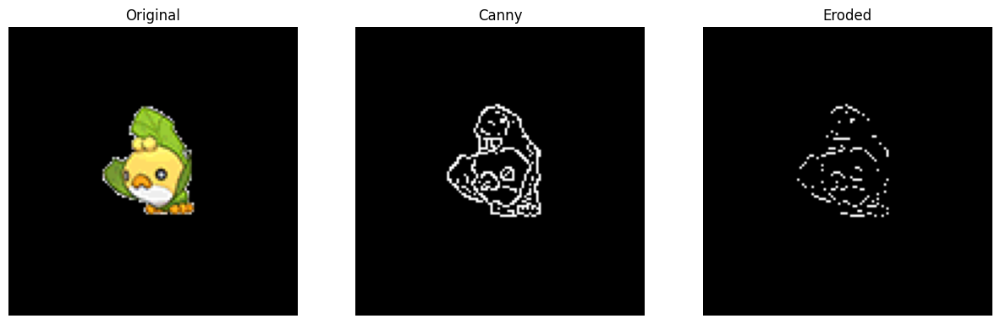

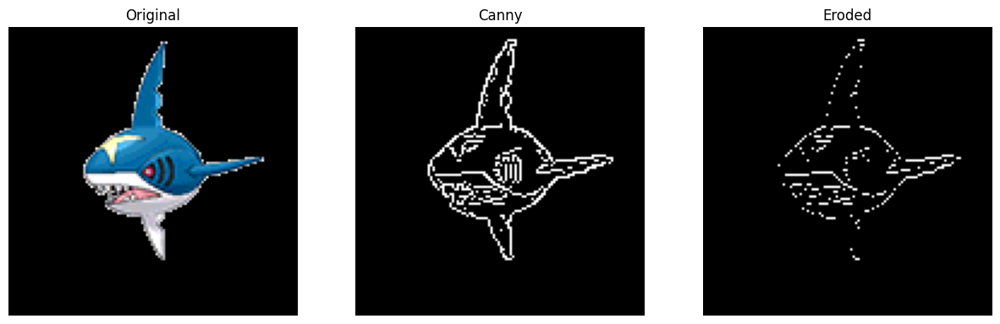

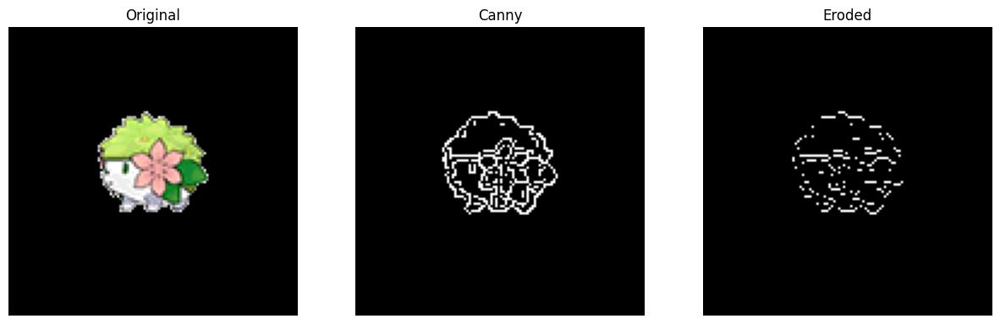

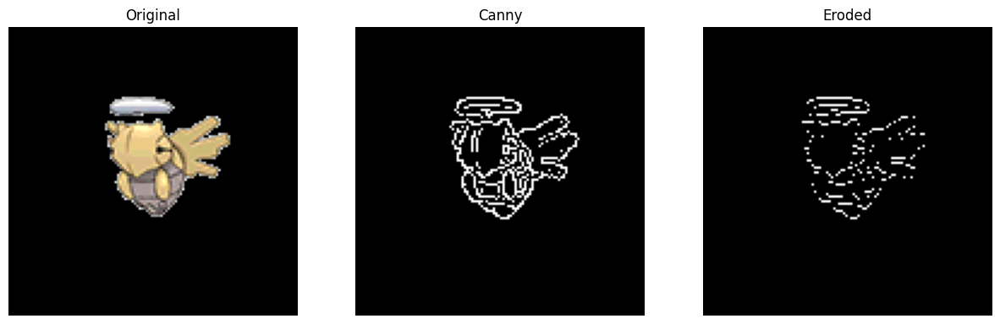

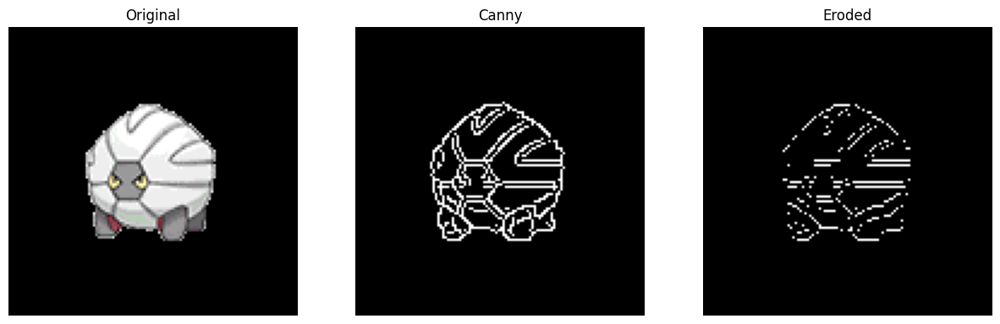

...

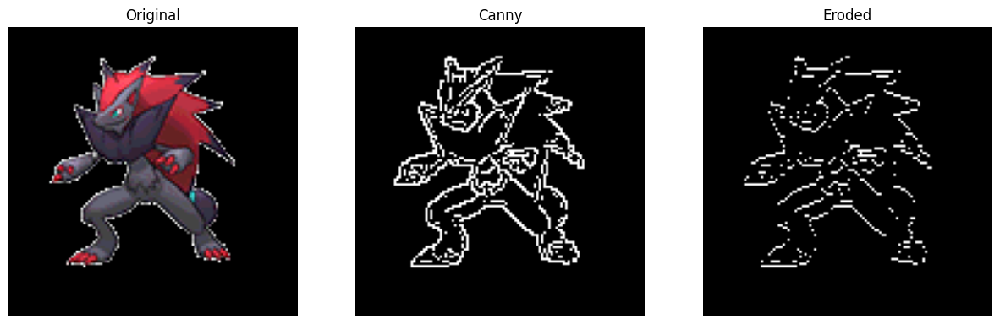

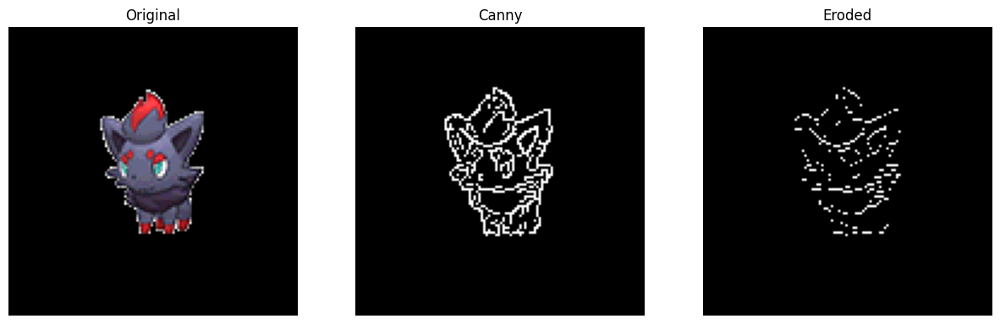

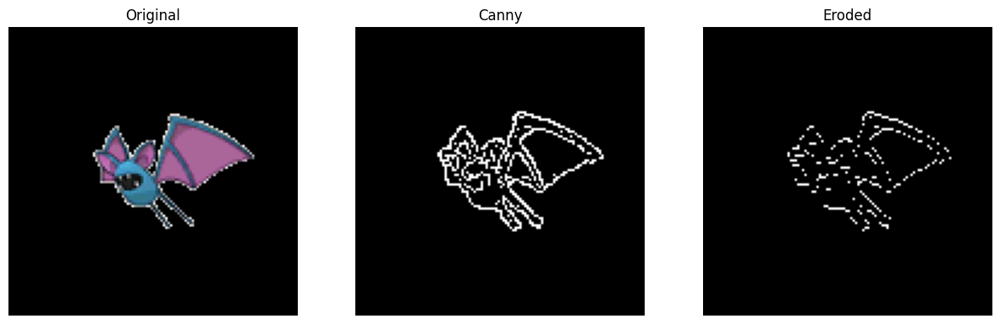

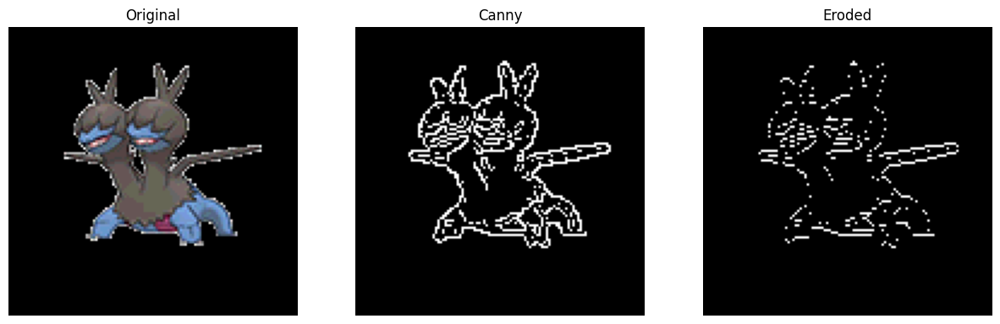

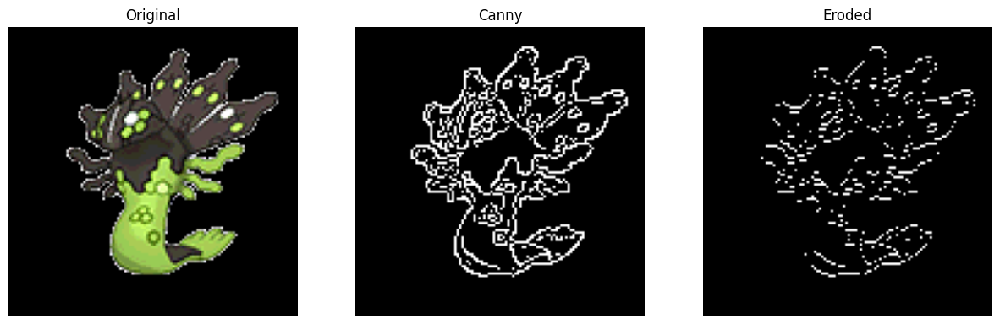

In [8]:

def display_table(dataframe):
    html = ""
    for _, row in dataframe.iterrows():
        fig, axs = plt.subplots(1, 3, figsize=(15, 5))

        # Original Image
        axs[0].imshow(row["Original Image"])
        axs[0].axis('off')
        axs[0].set_title("Original")

        # Canny Image
        axs[1].imshow(row["Canny Image"], cmap="gray")
        axs[1].axis('off')
        axs[1].set_title("Canny")

        # Eroded Image
        axs[2].imshow(row["Eroded Image"], cmap="gray")
        axs[2].axis('off')
        axs[2].set_title("Eroded")

        plt.show()
        html += f"<h3>{row['Name']}</h3>"

# Display the images in a table format
display_table(df)